## How to run the code:

### Requirements:
None.

### Instructions:
The code written Python 3.8 and stored in the `methuselah_finder` folder.

The code can be run only from the `genetic_methuselah_finder.py` explicitly inside the `methuselah_finder` folder without any configuration at all (it includes virtual environment which contains Python 3.8).

### To run the code from the folder explicitly:

1. Open Terminal or CMD and navigate to `methuselah_finder` folder.

2. Run the next command:

> Windows:
<br>`.\venv\bin\python3 genetic_methuselah_finder.py`

> Linux / MacOS:
<br>`./venv/bin/python3 genetic_methuselah_finder.py`

**OR** 
If you have `PyCharm` installed, just run the `genetic_methuselah_finder.py` file from the `PyCharm` editor.

### Output Examples:
The output values of the genetic algorithm should contain information on each generation, such as:
- Generation Number
- Maximum Fitness Value at Generation
- List of the Current Population
- List of Fitness Values for each Solution
- If the Shake Operation performed  
and more.

Here's an example of output of a run:<br><br>

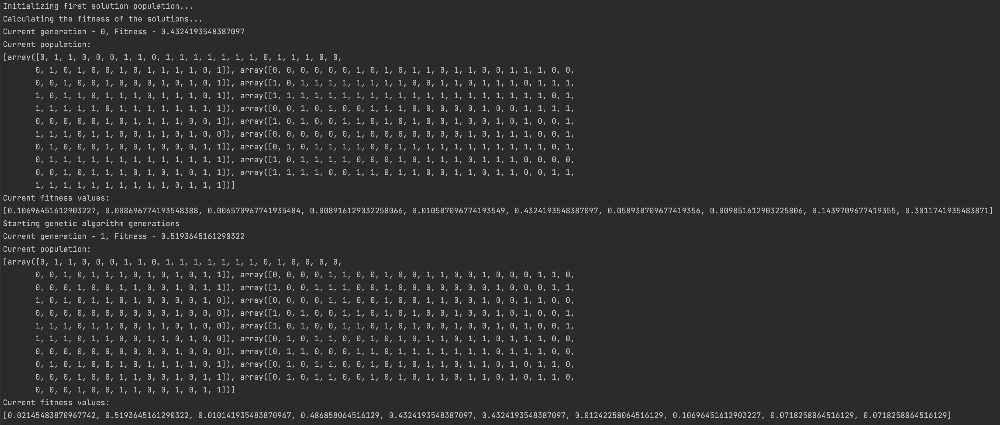

_...Omitted for brevity..._

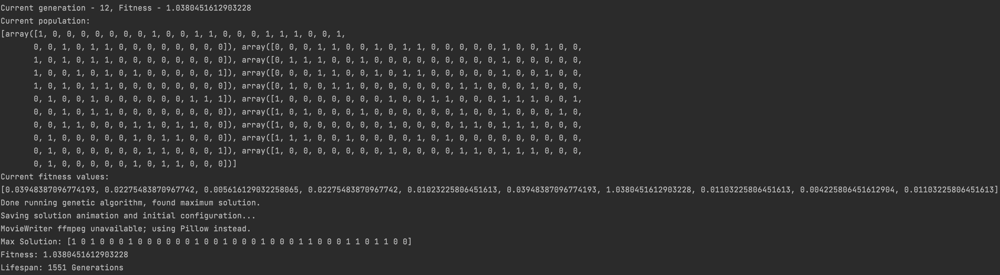

## How the genetic algorithm implemented?


### Representation of solutions
An individual solution is a flat array of 0's and 1's with exponential size (which represent ZxZ matrix).  
The solutions respresent initial configuration in the _"Game of Life"_, where 1's are live cells and 0's are dead cells.  
Each initial configuration is in form of ZxZ matrix, which I find out to be more useful than any other forms that I have tested.  
After testing some Z values for the size of the matrix (ZxZ), I find out that Z=6 (6x6 matrix size) is the optimal value for fast execution with small generations.<br><br>
Example of initial configuration:<br><br>
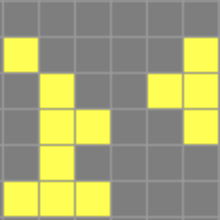
<br>
Representation as solution (reshaped as 6x6 matrix for better readablity, in practice it's flat array):<br>
```
  [[0, 0, 0, 0, 0, 0],
   [1, 0, 0, 0, 0, 1],
   [0, 1, 0, 0, 1, 1],
   [0, 1, 1, 0, 0, 1],
   [0, 1, 0, 0, 0, 0],
   [1, 1, 1, 0, 0, 0]]
```


### Genetic operators and selection mechanism
- **Selection Mechanism** - The selection mechanism chosen for this task is _**Roulette Whell Selection**_.


- **Crossover** - The crossover of two parent solutions into one offpring occurred by intersection of both parents at crossover point (which by default is the middle location in the solutions, or random location when there's a detection of less unique solutions in the solution population - will be discussed on _**Detection of uniquness of solutions**_).<br>
After both parents intersect at the crossover point, we concatenate one of each intersection parts of each parent with another, making two new offsprings.<br>
Then, single offspring from the two is selected by random choice.


- **Mutation** - The mutation of solution performed by flipping the values in the solution - 1's became 0's and 0's became 1's.<br>
In case of detection of less unique solutions in the solution population, the mutation performed is random location flipping in the solution array.

**NOTE:** The crossover and mutation not occurred always, and based on _**Crossover Probability**_ and _**Mutation Probability**_ which are defined in before the algorithm execution.

### Fitness function
The fitness function is calculated by the following formula:<br><br>
$$ Fitness(Solution) = SolutionPeakCellCoverage + LifespanPercentageOfSolution $$

_**Solution Peak Cell Coverage**_ -
The solution peak cell coverage is calculated as the percentage of cell coverage, at the peak cell coverage of all the solution history in the GOL board.  
Meaning we count the number of cells for the state which has the highest number of living cells, and take the percentage of it in comparison to the whole world cells number.

_**Lifespan Percentage of Solution**_ -
The lifespan percentage of solution is calculated as the percentage of the generations number the solution ran without reaching steady or circular state, in comparison to the whole generations the simulation of the solution ran.  

### How we check for steady or circular state in solution simulation?
Because the _Game of Life_ is **deterministic**, we can be sure that if some state occurred once - if it will occur once more it will re-run the same states it previously ran.<br><br>
Because of that behaviour, we can check for the history of _Game of Life_ states, and search for unique states.<br>
When we will find unique state more than once, it means we found circular state!<br>
The same observation can be related to steady states, because the next state will be the same as the previous - meaning it also will be found too.

**NOTE:** We check the lifespan by using this trick, but we are limited to the number of generations the simulation ran (we cannot check for infinity because of runtime limitations).

### Detection of uniqueness of solutions in solutions population
When the population of solutions reach curtain level of duplicates solution, we must 'shake' the solutions to avoid getting stuck with the same solutions over and over.  
We measure the uniquness of solutions by checking the percentage of unique fitness values across all the solutions - if we reach the threshold we define for uniqueness percentage - we perform the 'shake' operation.

_**Shake Operation**_ - The shake operation performed only in the next generation.  
It force random mutation on every solution - making the solution flipping the values in random locations rather at the all locations.  
Also, the crossover in the next generation will be done in random crossover point, rather than the original intersection point which is the middle location of the solution.

**NOTE:**
The duplicate solution threshold we specify is in term of percentage of unique solution allowed - if the threshold is **0.3 (30%)**, we allow no less than **30%** duplicates solutions (Meaning if we have only 2 unique solution's fitness from the solutions population, we will perform the shake operation).

### Game Of Life Simulation
We use a library called `seagull` which handles all the simulation of the _Game of Life_ and creates neat animation of the simulation performed.  
The library can also return an array of matrices, which each matrix represent single stage in the GOL board, which helps with measurement lifespan of solutions.  

### Configuration for the algorithm
All the neccesary configuration for the genetic algorithm, can be found in the `settings.py` file under the `methuselah_finder` folder.  

>#### Miscellaneous Settings<br><br>
**BOARD_SIZE** _(Default=100)_ - The board size area (matrix of ZxZ if Z is the board size value).<br><br>
**ANIMATION_FILE_NAME** _(Default='methuselah_found_X.gif')_ - The animation file name to save the maximal solution animation found on the GOL board.<br><br>
**INITIAL_CONFIGURATION_FILE_NAME** _(Default='methuselah_found_conf_X.png')_ - The initial configuration file name to save the image of the initial configuration of the maximal solution found.<br><br>

> #### Genetic Algorithm Settings<br><br>
**MAX_GENERATIONS** _(Default=50)_ - The maximum generation the genetic algorithm will run until stopping and returning the best solution found yet (If not reach other condition yet).<br><br>
**MAX_FITNESS** _(Default=1.0)_ - The maximum fitness value of solution that will cause the genetic algorithm to stop running (If not reach other condition yet).<br><br>
**DIFF_SOLUTION_THRESHOLD** _(Default=0.3)_ - The percentage of duplicate solutions allowed (By using the uniqueness of the fitness values) before the genetic algorithm will perform the 'shake' operation (Any value below that will cause the genetic algorithm to perform the 'shake' operation).<br><br>

> #### Probabilites Settings<br><br>
**CROSSOVER_PROB** _(Default=0.6)_ - The probability to perform a crossover on two parent solutions.<br><br>
**MUTATION_PROB** _(Default=0.5) - The probability to perform mutation on solution.<br><br>

> #### Population and individual solution size<br><br>
**POPULATION_SIZE**  _(Default=10)_ - The solution population size, for the whole genetic algorithm.<br><br>
**INDIVIDUAL_SIZE** _(Default=36)_ - The individual solution size (Which represent a matrix of intial state configuration of the suspected methuselah). It must be an exponent of number!<br><br>

> #### Fitness settings<br><br>
**FITNESS_GENERATION_BOUND** _(Default=1550)_ - The generation bound to perform the simulation on.<br>
This is the number of generation the simulation will run for, and also determines the maximum generation a solution can run (We limit ourselves to this bound, rather than running for infinity because of runtime limitations).

## Methuselah Founds:
All methuselah's images also can be found in the `methuselah_finder` folder.  
For each methuselah, the initial configuration can be found in file named `methuselah_found_conf_X.png` where `X` is the number of the methuselah.  
Also the animation which shows how the methuselah evolves, can be found in file names `methuselah_found_X.gif`.

### Methuselah One:
> **Selection Mechanism:** Roulette Whell<br><br>
> **Initial Configuration:** <br>
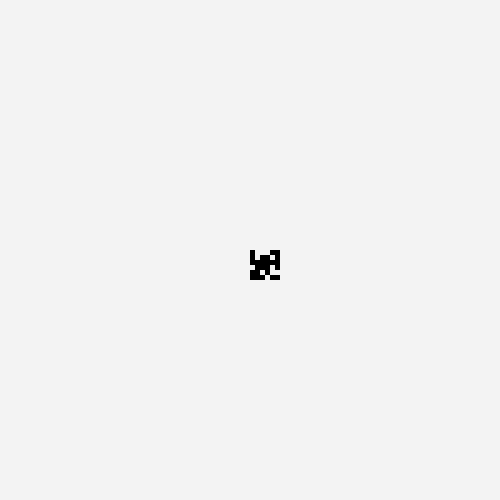

> **Representation as an array (6x6)**:
> ``` 
  [[1, 0, 0, 0, 1, 1],
   [1, 0, 1, 1, 0, 1],
   [1, 1, 1, 1, 1, 1],
   [0, 1, 1, 1, 0, 1],
   [1, 1, 0, 1, 0, 0],
   [1, 1, 1, 0, 1, 1]]
  ```


> **Fitness**: 0.776383870967742 <br>
> **Lifespan**: 1140 Generations <br><br>
> **Animation:** <br>
> 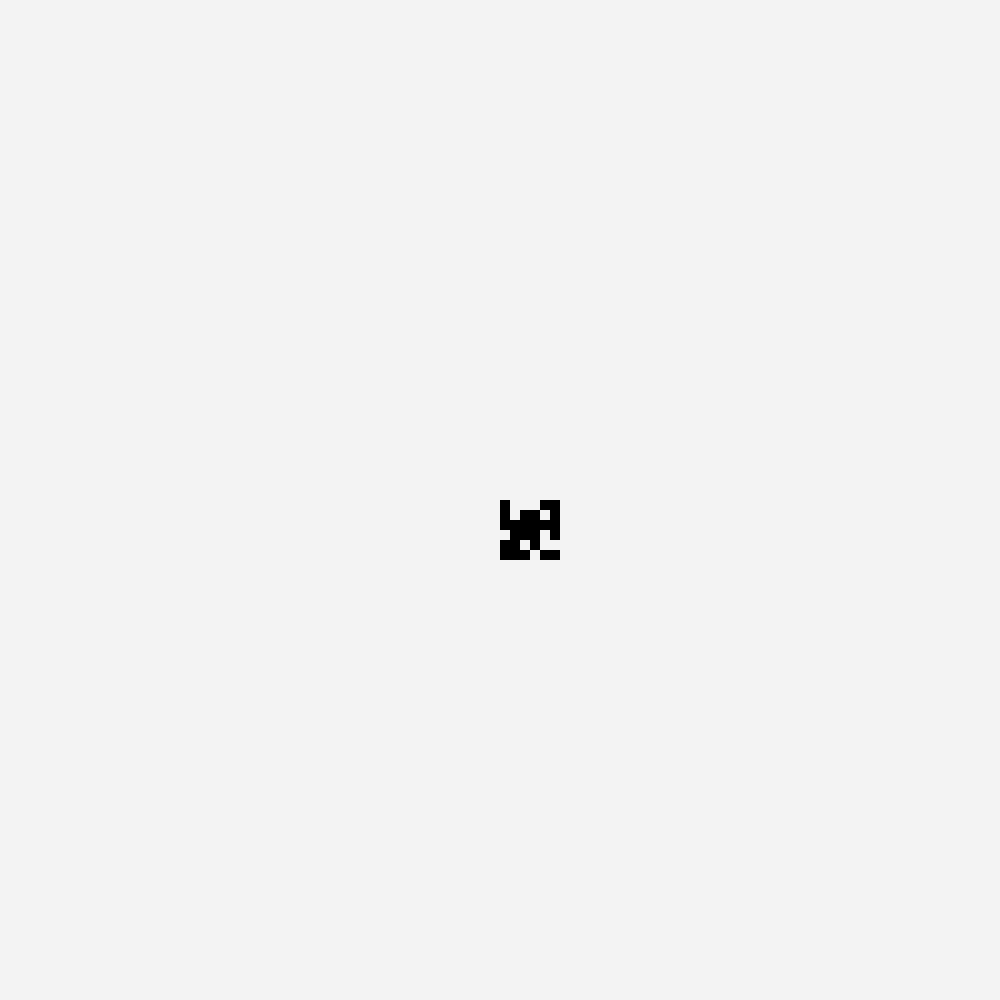


### Methuselah Two:
> **Selection Mechanism:** Random<br><br>
> **Initial Configuration:** <br>
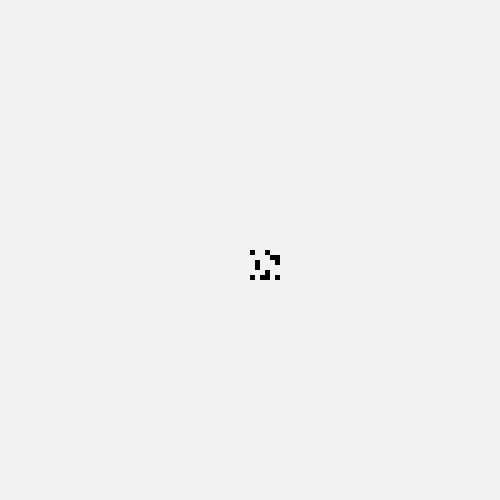

> **Representation as an array (6x6)**:
> ``` 
    [[1, 0, 0, 1, 0, 0],
     [0, 0, 0, 0, 1, 1],
     [0, 1, 0, 0, 0, 1],
     [0, 1, 0, 0, 0, 0],
     [0, 0, 0, 1, 0, 0],
     [1, 0, 1, 1, 0, 1]]
  ```


> **Fitness**: 1.0401451612903228<br>
> **Lifespan**: 1401 Generations <br>
>
> **Animation:**<br>
> 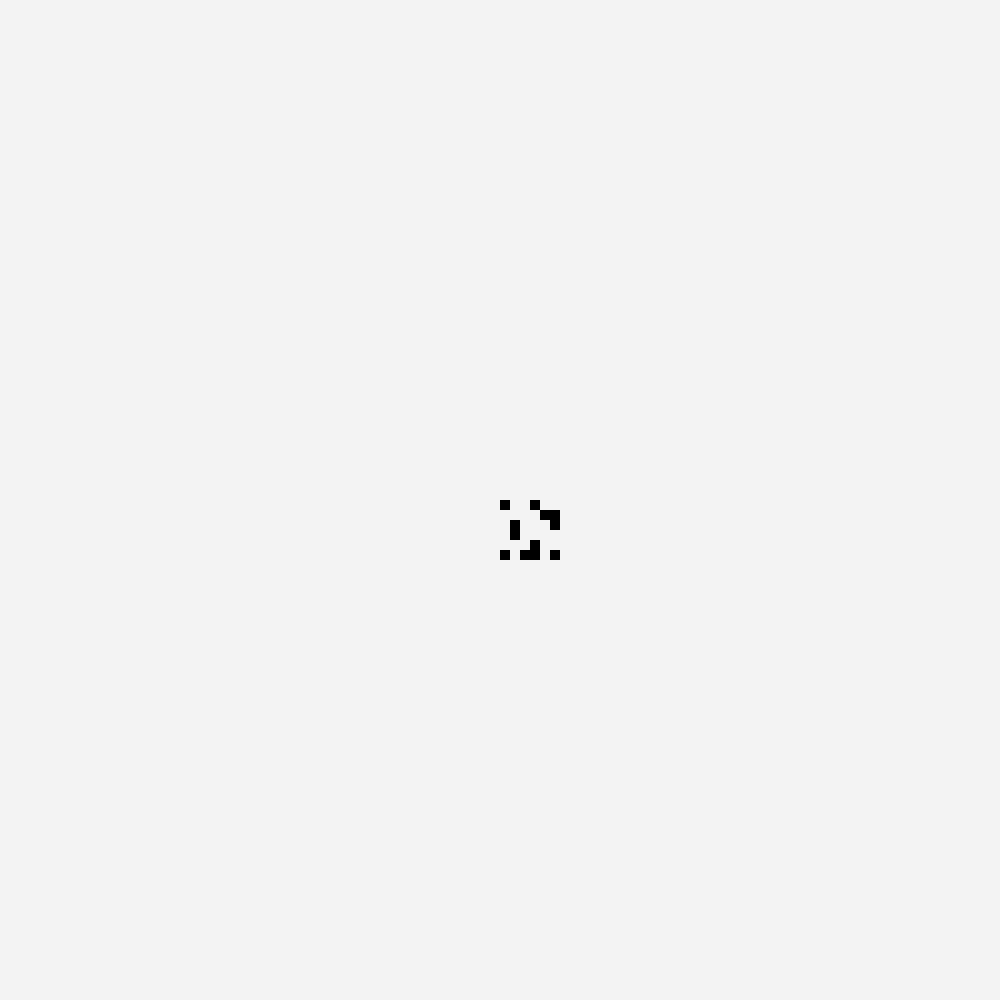

### Methuselah Three
> **Selection Mechanism:** Roulette Wheel<br><br>
> **Initial Configuration:**<br><br>
> 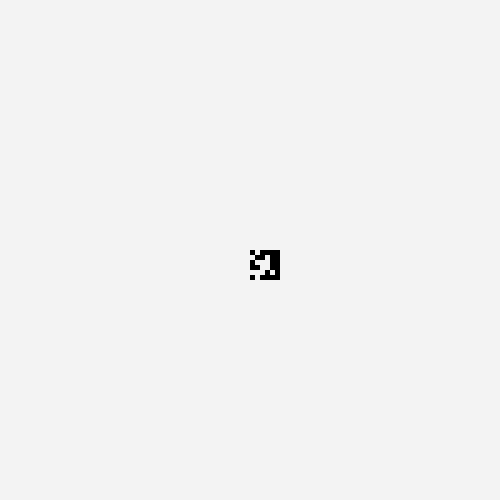<br>
> **Representation as an array (6x6):**<br>
> ```
      [[1, 0, 1, 1, 1, 1],
       [0, 1, 1, 0, 1, 1],
       [1, 0, 0, 0, 1, 1],
       [1, 1, 0, 0, 1, 1],
       [0, 0, 0, 1, 0, 1],
       [1, 0, 1, 1, 1, 1]]
> ```

> **Fitness:** 1.0579451612903226<br>
> **Lifespan:** 1550 Generations<br><br>
> **Animation:**<br><br>
> 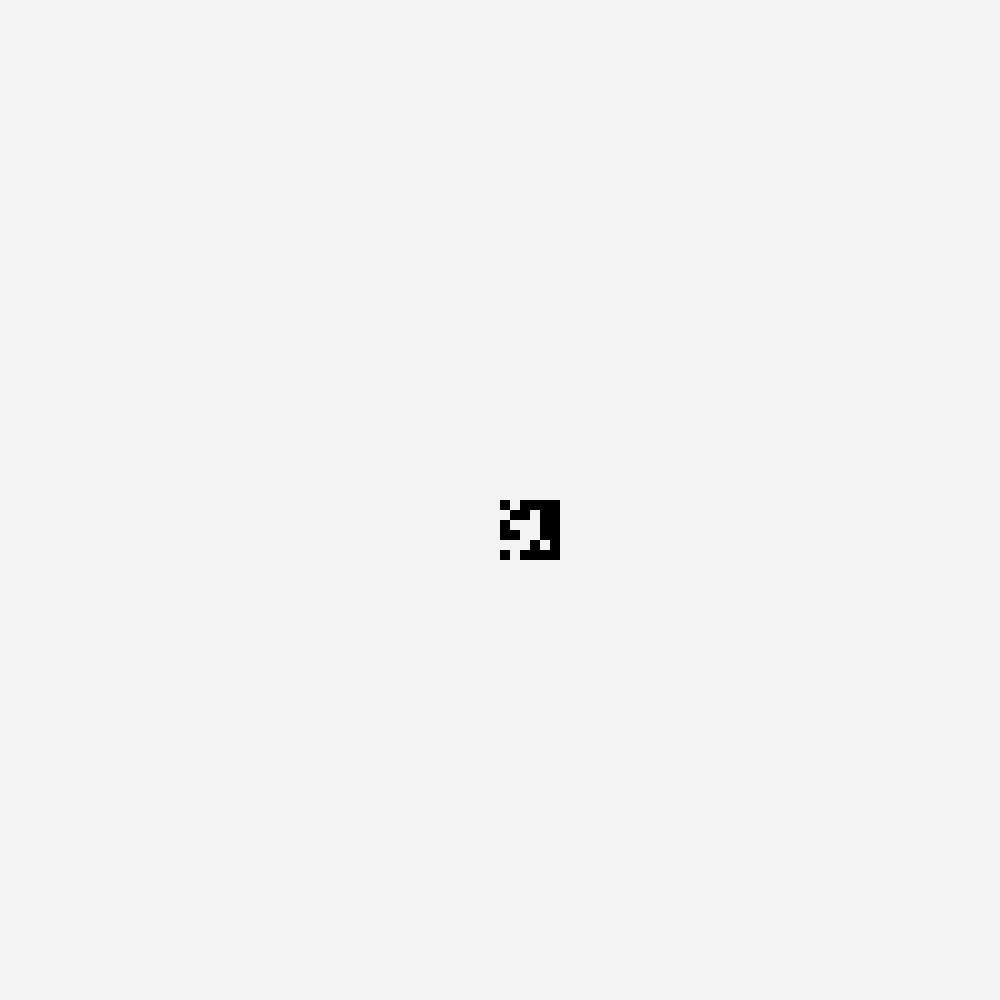

## Analysis of the genetic algorithm:

### Fitness graph over the solution populations
In the following graphs, we can see evolution of 3 runs which monitors the max fitness in each generation.<br><br>
The genetic algorithm configuration in the 3 runs:<br>
**Maximum Generations=50<br>Maximum Fitness=1<br>Different Solutions Threshold=0.3<br>Crossover Probability=0.6<br>Mutation Probability=0.5<br>Population Size=10<br>Individual Size=36**

> ### Graph 1
> 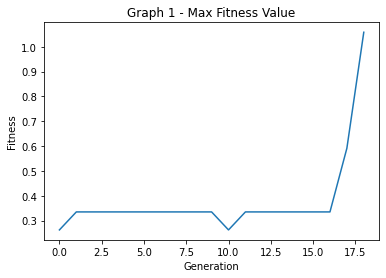

> In this graph, we can see that the max fitness value stayed at ~0.35 for almost 9 generations, until in generation 10, it went down below that.  
> We can assume that a mutation on the max fitness value, created that disruption, because in the next generation we can see it goes back to the previous fitness value.  
> The spike we see at generation 16, caused of lack of unique solutions.  
> The genetic algorithm 'shook' the solutions by forcing mutations and crossover on random point in the next generation, therefore creating the maximal fitness for the solution population.<br><br>
> **NOTE:** We noticed that the 'shake' operation of the genetic algorithm found many diversion points on the genetic algorithm, most of the time when the 'shake' operation occurred, the maximal solution found.

> ### Graph 2
> 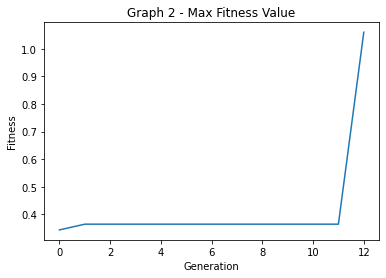

> This graph similar to the previous one, but stays on fitness level of ~0.37 for most of the generations (0 to 11).<br>
> But in the 11 generation, the diversion point discussed (the genetic algorithm 'shake' operation) created new solutions and found the maximal solution fitness.

> ### Graph 3
> 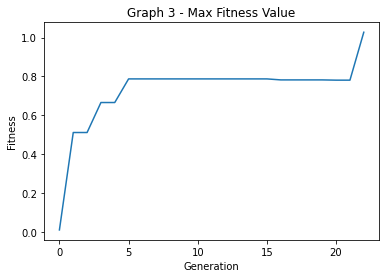

> In this graph, we can see how the algorithm evolves from generation to generation, providing better maximum fitness.<br>
> The first generations have huge peaks, mostly occurred by crossover operations between the solutions populations.<br>
> And again, we ran until generation 19, which contains small group of unique solutions which by the 'shake' operation, let the algorithm find the maximal solution.

### Conclusion:
By the trail and error techniques showing in the above graphs (and more runs which are excluded from this notebook due to readability reasons) we can assume that the 'shake' operation by the genetic algorithm is the key in the implemented algorithm to find proper solutions.

The mutation forcing using random shuffling can create new solutions and crossover in different point will random the solution intersection points which can result in interesting solutions.

Also because the different solution threshold is low, we can see that the solutions that stuck is probably good solutions but not enough.  
Therefore the 'shake' operation can occure different on each solution (remember that the solutions are most likely the same, spreaded by the different solution threshold allowed) which can create new solutions which using the previous good solution in different ways.

And the interesting notable assumption found, that in most of the runs - close to the 'shake' operation generation, we can found the generation which has the maximal fitness value (and therefore the maximal solution found).